

## 1. Importing Necessary Libraries

In [248]:
%matplotlib inline
import lightgbm as lgb
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pandas_profiling as pp
import seaborn as sns
from catboost import CatBoostClassifier
from lightgbm import LGBMClassifier
from sklearn import metrics
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import precision_score, f1_score, recall_score
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from xgboost import XGBClassifier

## 2. Importing Dataset

In [249]:
data = pd.read_csv(r'dataset_of_diabetes.csv')

# show the data of how many rows and columns
print("Data Shape - ", data.shape)
data.head(5)

Data Shape -  (1000, 14)


,ID,No_Pation,Gender,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI,CLASS
0,502,17975,F,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,N
1,735,34221,M,26,4.5,62,4.9,3.7,1.4,1.1,2.1,0.6,23.0,N
2,420,47975,F,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,N
3,680,87656,F,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,N
4,504,34223,M,33,7.1,46,4.9,4.9,1.0,0.8,2.0,0.4,21.0,N


## 3. Understanding the Data

In [250]:
# description of the current data set
data.describe()

,ID,No_Pation,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI
count,1000.000000,1.000000e+03,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,340.500000,2.705514e+05,53.528000,5.124743,68.943000,8.281160,4.862820,2.349610,1.204750,2.609790,1.854700,29.578020
std,240.397673,3.380758e+06,8.799241,2.935165,59.984747,2.534003,1.301738,1.401176,0.660414,1.115102,3.663599,4.962388
min,1.000000,1.230000e+02,20.000000,0.500000,6.000000,0.900000,0.000000,0.300000,0.200000,0.300000,0.100000,19.000000
25%,125.750000,2.406375e+04,51.000000,3.700000,48.000000,6.500000,4.000000,1.500000,0.900000,1.800000,0.700000,26.000000
50%,300.500000,3.439550e+04,55.000000,4.600000,60.000000,8.000000,4.800000,2.000000,1.100000,2.500000,0.900000,30.000000
75%,550.250000,4.538425e+04,59.000000,5.700000,73.000000,10.200000,5.600000,2.900000,1.300000,3.300000,1.500000,33.000000
max,800.000000,7.543566e+07,79.000000,38.900000,800.000000,16.000000,10.300000,13.800000,9.900000,9.900000,35.000000,47.750000


In [251]:
data.describe(include=np.object).transpose()

C:\Users\alici\AppData\Local\Temp\ipykernel_1124\64643413.py:1: DeprecationWarning: `np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  data.describe(include=np.object).transpose()


,count,unique,top,freq
Gender,1000,3,M,565
CLASS,1000,5,Y,840


In [252]:
data['Gender'].value_counts(normalize=True)

M    0.565
F    0.434
f    0.001
Name: Gender, dtype: float64

In [253]:
data.Gender.unique()

array(['F', 'M', 'f'], dtype=object)

In [254]:
data.tail()

,ID,No_Pation,Gender,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI,CLASS
995,200,454317,M,71,11.0,97,7.0,7.5,1.7,1.2,1.8,0.6,30.0,Y
996,671,876534,M,31,3.0,60,12.3,4.1,2.2,0.7,2.4,15.4,37.2,Y
997,669,87654,M,30,7.1,81,6.7,4.1,1.1,1.2,2.4,8.1,27.4,Y
998,99,24004,M,38,5.8,59,6.7,5.3,2.0,1.6,2.9,14.0,40.5,Y
999,248,24054,M,54,5.0,67,6.9,3.8,1.7,1.1,3.0,0.7,33.0,Y


In [255]:
# check out if the data has all the data
data.isnull().values.any()

False

In [256]:
# to know the data type of the features
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 14 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   ID         1000 non-null   int64  
 1   No_Pation  1000 non-null   int64  
 2   Gender     1000 non-null   object 
 3   AGE        1000 non-null   int64  
 4   Urea       1000 non-null   float64
 5   Cr         1000 non-null   int64  
 6   HbA1c      1000 non-null   float64
 7   Chol       1000 non-null   float64
 8   TG         1000 non-null   float64
 9   HDL        1000 non-null   float64
 10  LDL        1000 non-null   float64
 11  VLDL       1000 non-null   float64
 12  BMI        1000 non-null   float64
 13  CLASS      1000 non-null   object 
dtypes: float64(8), int64(4), object(2)
memory usage: 109.5+ KB


In [257]:
data['CLASS'].value_counts(normalize=True)

Y     0.840
N     0.102
P     0.053
Y     0.004
N     0.001
Name: CLASS, dtype: float64

In [258]:
data['Gender'] = data.apply(lambda row: 0 if row['Gender'] == 'M' else 1, axis=1)

In [259]:
data['Gender'].value_counts(normalize=True)


0    0.565
1    0.435
Name: Gender, dtype: float64

In [260]:
data.CLASS.unique()

array(['N', 'N ', 'P', 'Y', 'Y '], dtype=object)

In [261]:
data['Gender'].value_counts(normalize=True)


0    0.565
1    0.435
Name: Gender, dtype: float64

In [262]:
data.CLASS.unique()

array(['N', 'N ', 'P', 'Y', 'Y '], dtype=object)

In [263]:
# fix space in the data in CLASS column
def fix_class(row):
    if row['CLASS'] == 'N':
        return 0
    elif row['CLASS'] == 'P':
        return 1
    elif row['CLASS'] == 'Y':
        return 2
    elif row['CLASS'] == 'N ':
        return 0
    elif row['CLASS'] == 'Y ':
        return 2

In [264]:
data['CLASS'] = data.apply(lambda row: fix_class(row), axis=1)
data.CLASS.unique()

array([0, 1, 2], dtype=int64)

In [265]:
data.head()

,ID,No_Pation,Gender,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI,CLASS
0,502,17975,1,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,0
1,735,34221,0,26,4.5,62,4.9,3.7,1.4,1.1,2.1,0.6,23.0,0
2,420,47975,1,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,0
3,680,87656,1,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,0
4,504,34223,0,33,7.1,46,4.9,4.9,1.0,0.8,2.0,0.4,21.0,0


In [266]:
data.tail()

,ID,No_Pation,Gender,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI,CLASS
995,200,454317,0,71,11.0,97,7.0,7.5,1.7,1.2,1.8,0.6,30.0,2
996,671,876534,0,31,3.0,60,12.3,4.1,2.2,0.7,2.4,15.4,37.2,2
997,669,87654,0,30,7.1,81,6.7,4.1,1.1,1.2,2.4,8.1,27.4,2
998,99,24004,0,38,5.8,59,6.7,5.3,2.0,1.6,2.9,14.0,40.5,2
999,248,24054,0,54,5.0,67,6.9,3.8,1.7,1.1,3.0,0.7,33.0,2


# 4. Data Profiling Report

In [267]:
pp.ProfileReport(data)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# 5. EDA (Exploratory Data Analysis)

 ####     5.1   Drop out unnecessary column

In [268]:
data_new = data.drop(['ID', 'No_Pation'], axis=1)

### 5.2 Let's check if there are any null variables in the data_new dataset

In [269]:
data_new.isnull().sum()

Gender    0
AGE       0
Urea      0
Cr        0
HbA1c     0
Chol      0
TG        0
HDL       0
LDL       0
VLDL      0
BMI       0
CLASS     0
dtype: int64

# 6. Feature Engineering

### 6.1 Pearson correlation

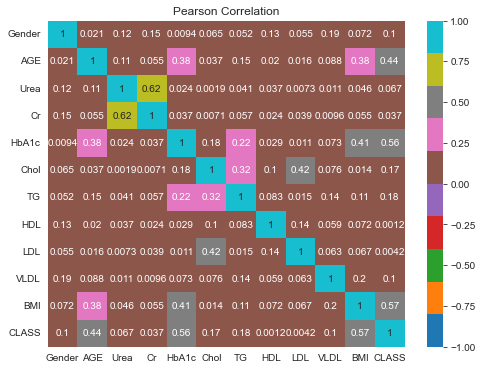

HDL       0.001248
LDL       0.004247
Cr        0.037500
Urea      0.067010
VLDL      0.101247
Gender    0.103397
Chol      0.167375
TG        0.182299
AGE       0.443009
HbA1c     0.555321
BMI       0.569879
CLASS     1.000000
Name: CLASS, dtype: float64


In [270]:
corr = data_new.corr(method='pearson').abs()

corr.describe()
corr.head()

fig = plt.figure(figsize=(8, 6))
sns.heatmap(corr, annot=True, cmap='tab10', vmin=-1, vmax=+1)
plt.title('Pearson Correlation')
plt.show()

print(data_new.corr()['CLASS'].abs().sort_values())


### 6.2 Univariate Selection using SelectKBest

In [271]:
#independent columns
X = data_new.iloc[:, 0:20]
#target column
y = data_new.iloc[:, -1]

#apply SelectKBest class to extract top 10 best features
bestfeatures = SelectKBest(score_func=chi2, k=10)
fit = bestfeatures.fit(X, y)
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(X.columns)

#concat two dataframes for better visualization
featurescores = pd.concat([dfcolumns, dfscores], axis=1)
#naming the dataframe columns
featurescores.columns = ['Specs', 'Score']
#print 10 best features
print(featurescores.nlargest(13, 'Score'))

     Specs       Score
1      AGE  319.999268
10     BMI  281.183581
4    HbA1c  241.741439
11   CLASS  228.557725
9     VLDL   80.330250
3       Cr   73.363497
6       TG   27.893108
0   Gender   10.283893
5     Chol    9.761831
2     Urea    9.272571
7      HDL    0.309676
8      LDL    0.294061


### 6.3 Feature Importance

[0.00660601 0.03905144 0.00429403 0.00454195 0.0951596  0.01094158
 0.01038154 0.00427788 0.00643932 0.00956948 0.07960794 0.72912925]


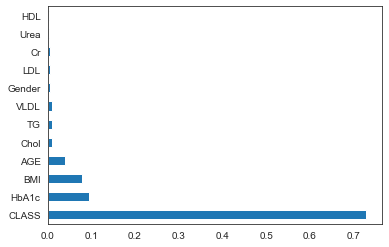

In [272]:
#independent columns
X = data_new.iloc[:, 0:20]
#target column
y = data_new.iloc[:, -1]

model = ExtraTreesClassifier()
model.fit(X, y)
print(model.feature_importances_)  #use inbuilt class feature_importances of tree based classifiers

#plot graph of feature importances for better visualization
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(13).plot(kind='barh')
plt.show()

### 6.4 Correlation Matrix with Heatmap

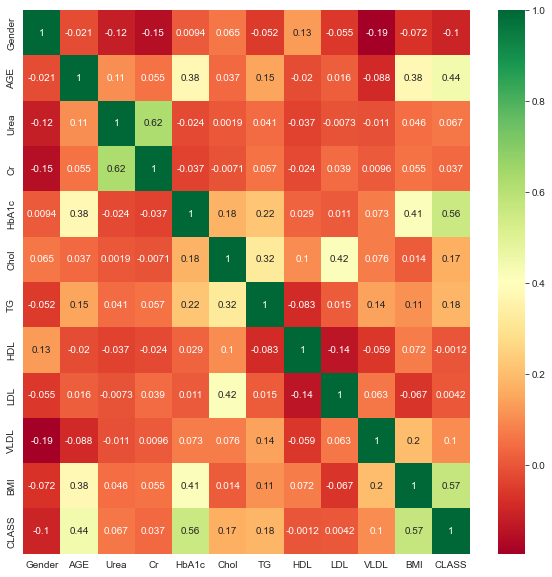

In [273]:
#independent columns
X = data_new.iloc[:, 0:20]
#target column
y = data_new.iloc[:, -1]

#get correlations of each features in dataset
corrmatrix = data_new.corr()
top_corr_features = corrmatrix.index
plt.figure(figsize=(10, 10))

#plot heat map
g = sns.heatmap(data_new[top_corr_features].corr(), annot=True, cmap="RdYlGn")

# 7. Applying Different Models On Train & Test Data #only suggestion feel free to try out other models :)

### 7.1) GBM (Gradient Boosting)


#### 7.1.1) LightGBM

c:\languages\python\python390\lib\site-packages\lightgbm\sklearn.py:736: UserWarning: 'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose' argument is deprecated and will be removed in a future release of LightGBM. "


[30]	training's multi_logloss: 0.072109	valid_0's multi_logloss: 0.225409
[60]	training's multi_logloss: 0.0196772	valid_0's multi_logloss: 0.225203
[90]	training's multi_logloss: 0.00591342	valid_0's multi_logloss: 0.240197
              precision    recall  f1-score   support

           0       0.87      0.81      0.84        91
           1       0.47      0.29      0.35        49
           2       0.95      0.98      0.97       760

    accuracy                           0.93       900
   macro avg       0.76      0.69      0.72       900
weighted avg       0.92      0.93      0.92       900

Training accuracy 1.000000
Testing accuracy 0.928889
-------------------------------------------------
the f1 score for Random Forest Classifier is : 0.7212080867666465
the precision score is : 0.7633737146663337
the recall score is : 0.6943705417389628
LightGBM Accuracy: 0.929
-------------------------------------------------
Number of mislabeled points out of a total 900 points : 64


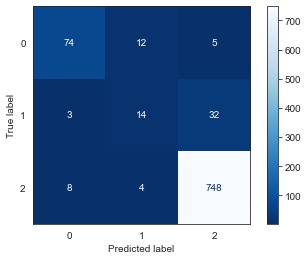

In [274]:
diabetes_lgb = data_new
diabetes_lgb.head()

# define input and output features to train model
X = diabetes_lgb.drop(['CLASS', 'Gender', 'VLDL'], axis=1)
y = diabetes_lgb.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.90, random_state=42)

model_lgb = lgb.LGBMClassifier(learning_rate=0.08, max_depth=-3, random_state=42)
model_lgb.fit(X_train, y_train, eval_set=[(X_test, y_test), (X_train, y_train)],
              verbose=30, eval_metric='logloss')

y_pred = model_lgb.predict(X_test)

print(metrics.classification_report(y_test, model_lgb.predict(X_test)))
print("Training accuracy {:4f}".format(model_lgb.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_lgb.score(X_test, y_test)))
print("-------------------------------------------------")

#lgb.plot_importance(model_lgb)
#lgb.plot_metric(model_lgb)
metrics.plot_confusion_matrix(model_lgb, X_test, y_test, cmap='Blues_r')

print("the f1 score for Random Forest Classifier is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("LightGBM Accuracy: %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

              precision    recall  f1-score   support

           0       0.93      0.90      0.91        77
           1       0.97      0.90      0.94        40
           2       0.98      0.99      0.99       633

    accuracy                           0.98       750
   macro avg       0.96      0.93      0.95       750
weighted avg       0.98      0.98      0.98       750

Training accuracy 1.000000
Testing accuracy 0.977333
-------------------------------------------------
the f1 score for Random Forest Classifier is : 0.9454645344936486
the precision score is : 0.9627303359697725
the recall score is : 0.9294016673163593
LightGBM Accuracy: 0.977
-------------------------------------------------
Number of mislabeled points out of a total 750 points : 17


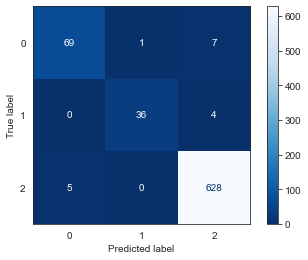

In [275]:
diabetes_lgbm = data_new
diabetes_lgbm.head()

# define input and output features to train model
X = diabetes_lgbm.drop('CLASS', axis=1)
y = diabetes_lgbm.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42, stratify=y)

preprocessor = make_pipeline(MinMaxScaler())

model_LightGBMPipeline = make_pipeline(preprocessor, LGBMClassifier(learning_rate=0.08, max_depth=-3, random_state=42))
model_LightGBMPipeline.fit(X_train, y_train)

y_proba = model_LightGBMPipeline.predict_proba(X_test)
y_pred = np.argmax(y_proba, axis=1)

print(metrics.classification_report(y_test, model_LightGBMPipeline.predict(X_test)))
print("Training accuracy {:4f}".format(model_LightGBMPipeline.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_LightGBMPipeline.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_LightGBMPipeline, X_test, y_test, cmap='Blues_r')

print("the f1 score for Random Forest Classifier is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("LightGBM Accuracy: %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

#### 7.1.2)  GBM

              precision    recall  f1-score   support

           0       1.00      0.99      0.99        77
           1       1.00      1.00      1.00        40
           2       1.00      1.00      1.00       633

    accuracy                           1.00       750
   macro avg       1.00      1.00      1.00       750
weighted avg       1.00      1.00      1.00       750

Training accuracy 1.000000
Testing accuracy 0.998667
-------------------------------------------------
the f1 score for Random Forest Classifier is : 0.9975582621016486
the precision score is : 0.9994742376445847
the recall score is : 0.9956709956709956
GBM Accuracy is: 0.999
-------------------------------------------------
Number of mislabeled points out of a total 750 points : 1


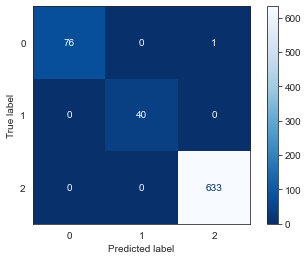

In [276]:
diabetes_gbm = data_new
diabetes_gbm.head()

# define input and output features to train model
X = diabetes_gbm.drop('CLASS', axis=1)
y = diabetes_gbm.CLASS

# train and test splitting
kf = KFold(n_splits=5, random_state=42, shuffle=True)

for train_index, val_index in kf.split(X):
    X_train, X_val = X.iloc[train_index], X.iloc[val_index]
    y_train, y_val = y.iloc[train_index], y.iloc[val_index]

model_gradient_booster = GradientBoostingClassifier(learning_rate=0.1)
model_gradient_booster.get_params()

model_gradient_booster.fit(X_train, y_train)

y_pred = model_gradient_booster.predict(X_test)

print(metrics.classification_report(y_test, model_gradient_booster.predict(X_test)))
print("Training accuracy {:4f}".format(model_gradient_booster.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_gradient_booster.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_gradient_booster, X_test, y_test, cmap='Blues_r')

print("the f1 score for Random Forest Classifier is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("GBM Accuracy is: %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

              precision    recall  f1-score   support

           0       0.96      0.92      0.94        77
           1       0.90      0.95      0.93        40
           2       0.99      0.99      0.99       633

    accuracy                           0.98       750
   macro avg       0.95      0.95      0.95       750
weighted avg       0.98      0.98      0.98       750

Training accuracy 1.000000
Testing accuracy 0.980000
-------------------------------------------------
the f1 score for Random Forest Classifier is : 0.951795876515506
the precision score is : 0.950534355897132
the recall score is : 0.9536731567537254
GBM2 Accuracy is: 0.980
-------------------------------------------------
Number of mislabeled points out of a total 750 points : 15


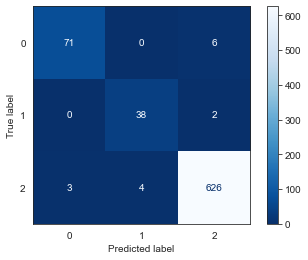

In [277]:
#anotherway of doing gbm
diabetes_gbm2 = data_new
diabetes_gbm2.head()

# define input and output features to train model
X = diabetes_gbm2.drop('CLASS', axis=1)
y = diabetes_gbm2.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42, stratify=y)

preprocessor = make_pipeline(MinMaxScaler())

model_GBMPipline = make_pipeline(preprocessor, GradientBoostingClassifier(learning_rate=0.1))
model_GBMPipline.fit(X_train, y_train)

y_proba = model_GBMPipline.predict_proba(X_test)
y_pred = np.argmax(y_proba, axis=1)

print(metrics.classification_report(y_test, model_GBMPipline.predict(X_test)))
print("Training accuracy {:4f}".format(model_GBMPipline.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_GBMPipline.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_GBMPipline, X_test, y_test, cmap='Blues_r')

print("the f1 score for Random Forest Classifier is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("GBM2 Accuracy is: %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

#### 7.1.3) XGBoost

              precision    recall  f1-score   support

           0       0.96      0.96      0.96        82
           1       1.00      0.86      0.92        43
           2       0.99      1.00      0.99       675

    accuracy                           0.98       800
   macro avg       0.98      0.94      0.96       800
weighted avg       0.99      0.98      0.98       800

Training accuracy 1.000000
Testing accuracy 0.985000
-------------------------------------------------
the f1 score for Random Forest Classifier is : 0.9598550255414059
the precision score is : 0.9833995917051682
the recall score is : 0.9398117686603222
XGBoost Accuracy is:  0.985
-------------------------------------------------
Number of mislabeled points out of a total 800 points : 12


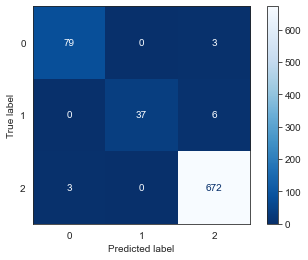

In [278]:
diabetes_xgb = data_new
diabetes_xgb.head()

# define input and output features to train model
X = diabetes_xgb.drop('CLASS', axis=1)
y = diabetes_xgb.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.80, random_state=42, stratify=y)

preprocessor = make_pipeline(MinMaxScaler())
model_XGBPipline = make_pipeline(preprocessor, XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
                                                             colsample_bynode=1, colsample_bytree=1, gamma=0,
                                                             learning_rate=0.1,
                                                             max_delta_step=0, max_depth=3, min_child_weight=1,
                                                             missing=1,
                                                             n_estimators=100, n_jobs=1, nthread=None,
                                                             objective='multi:softprob', random_state=0, reg_alpha=0,
                                                             reg_lambda=1, scale_pos_weight=None, seed=None,
                                                             silent=None,
                                                             subsample=1, verbosity=1))

model_XGBPipline.fit(X_train, y_train)

y_proba = model_XGBPipline.predict_proba(X_test)
y_pred = np.argmax(y_proba, axis=1)

print(metrics.classification_report(y_test, model_XGBPipline.predict(X_test)))
print("Training accuracy {:4f}".format(model_XGBPipline.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_XGBPipline.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_XGBPipline, X_test, y_test, cmap='Blues_r')

print("the f1 score for Random Forest Classifier is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("XGBoost Accuracy is:  %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

#### 7.1.4) CatBoost

0:	learn: 0.7749422	total: 34.2ms	remaining: 34.1s
1:	learn: 0.4996760	total: 53.3ms	remaining: 26.6s
2:	learn: 0.3461693	total: 72.7ms	remaining: 24.2s
3:	learn: 0.2463637	total: 94.3ms	remaining: 23.5s
4:	learn: 0.1774079	total: 102ms	remaining: 20.3s
5:	learn: 0.1353639	total: 123ms	remaining: 20.4s
6:	learn: 0.1009567	total: 144ms	remaining: 20.5s
7:	learn: 0.0766700	total: 168ms	remaining: 20.8s
8:	learn: 0.0590087	total: 192ms	remaining: 21.1s
9:	learn: 0.0465521	total: 212ms	remaining: 21s
10:	learn: 0.0377937	total: 234ms	remaining: 21s
11:	learn: 0.0322825	total: 255ms	remaining: 21s
12:	learn: 0.0270211	total: 277ms	remaining: 21s
13:	learn: 0.0234827	total: 300ms	remaining: 21.1s
14:	learn: 0.0202445	total: 323ms	remaining: 21.2s
15:	learn: 0.0180700	total: 345ms	remaining: 21.2s
16:	learn: 0.0158127	total: 366ms	remaining: 21.2s
17:	learn: 0.0134566	total: 387ms	remaining: 21.1s
18:	learn: 0.0119131	total: 414ms	remaining: 21.4s
19:	learn: 0.0106588	total: 438ms	remaining: 

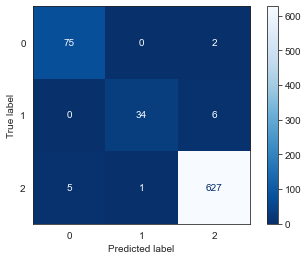

In [279]:
diabetes_catb = data_new
diabetes_catb.head()

# define input and output features to train model
X = diabetes_catb.drop('CLASS', axis=1)
y = diabetes_catb.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42, stratify=y)

preprocessor = make_pipeline(MinMaxScaler())
model_CatPipeline = make_pipeline(preprocessor, CatBoostClassifier(iterations=1000, loss_function='MultiClass',
                                                                   bootstrap_type="Bayesian",
                                                                   eval_metric='MultiClass',
                                                                   leaf_estimation_iterations=100,
                                                                   random_strength=0.5,
                                                                   depth=7,
                                                                   l2_leaf_reg=5,
                                                                   learning_rate=0.1,
                                                                   bagging_temperature=0.5,
                                                                   allow_writing_files=False))
model_CatPipeline.fit(X_train, y_train)

y_proba = model_CatPipeline.predict_proba(X_test)
y_pred = np.argmax(y_proba, axis=1)

print(metrics.classification_report(y_test, model_CatPipeline.predict(X_test)))
print("Training accuracy {:4f}".format(model_CatPipeline.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_CatPipeline.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_CatPipeline, X_test, y_test, cmap='Blues_r')

print("the f1 score for Random Forest Classifier is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("CatBoost Accuracy is :  %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

#### 7.1.5) AdaBoost

              precision    recall  f1-score   support

           0       0.94      0.87      0.91        77
           1       0.85      0.70      0.77        40
           2       0.97      0.99      0.98       633

    accuracy                           0.96       750
   macro avg       0.92      0.85      0.88       750
weighted avg       0.96      0.96      0.96       750

Training accuracy 1.000000
Testing accuracy 0.958667
-------------------------------------------------
the f1 score for Random Forest Classifier is : 0.8827636691282305
the precision score is : 0.9193636975872183
the recall score is : 0.8519706202170657
Adaboost Accuracy is : 0.959
-------------------------------------------------
Number of mislabeled points out of a total 750 points : 31


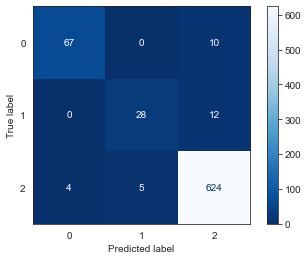

In [280]:
diabetes_adab = data_new
diabetes_adab.head()

# define input and output features to train model
X = diabetes_adab.drop('CLASS', axis=1)
y = diabetes_adab.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42, stratify=y)

preprocessor = make_pipeline(MinMaxScaler())
model_AdaPipeline = make_pipeline(preprocessor, AdaBoostClassifier(n_estimators=200, learning_rate=1.4))

model_AdaPipeline.fit(X_train, y_train)

y_proba = model_AdaPipeline.predict_proba(X_test)
y_pred = np.argmax(y_proba, axis=1)

print(metrics.classification_report(y_test, model_AdaPipeline.predict(X_test)))
print("Training accuracy {:4f}".format(model_AdaPipeline.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_AdaPipeline.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_AdaPipeline, X_test, y_test, cmap='Blues_r')

print("the f1 score for Random Forest Classifier is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("Adaboost Accuracy is : %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

### 7.2) Logistic Regression


c:\languages\python\python390\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\languages\python\python390\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\languages\python\python390\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.00      0.00      0.00        77
           1       0.00      0.00      0.00        40
           2       0.84      0.98      0.91       633

    accuracy                           0.83       750
   macro avg       0.28      0.33      0.30       750
weighted avg       0.71      0.83      0.77       750

Training accuracy 0.840000
Testing accuracy 0.830667
-------------------------------------------------
the f1 score for Random Forest Classifier is : 0.6921349785857919
the precision score is : 0.7340628429236024
the recall score is : 0.6738902224684216
Logistic Regression Accuracy is : 0.921
-------------------------------------------------
Number of mislabeled points out of a total 750 points : 59


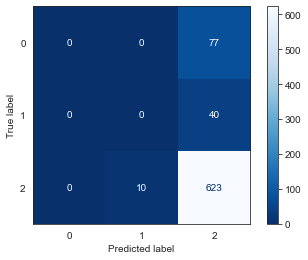

In [281]:
diabetes_lr = data_new
diabetes_lr.head()

# define input and output features to train model
X = diabetes_lr.drop('CLASS', axis=1)
y = diabetes_lr.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42, stratify=y)

sc = StandardScaler()
sc.fit(X_train)
X_train_std = sc.transform(X_train)
X_test_std = sc.transform(X_test)

# Create an instance of LogisticRegression classifier
model_lr = LogisticRegression(C=100.0, random_state=1, solver='lbfgs', multi_class='ovr')

# Fit the model
model_lr.fit(X_train_std, y_train)

# Create the predictions
y_pred = model_lr.predict(X_test_std)

print(metrics.classification_report(y_test, model_lr.predict(X_test)))
print("Training accuracy {:4f}".format(model_lr.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_lr.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_lr, X_test, y_test, cmap='Blues_r')

print("the f1 score for Random Forest Classifier is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("Logistic Regression Accuracy is : %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

### 7.3) Random Forest Classifier


              precision    recall  f1-score   support

           0       0.95      0.96      0.95        77
           1       0.97      0.70      0.81        40
           2       0.98      0.99      0.98       633

    accuracy                           0.97       750
   macro avg       0.96      0.88      0.92       750
weighted avg       0.97      0.97      0.97       750

Training accuracy 1.000000
Testing accuracy 0.973333
-------------------------------------------------
the f1 score for Random Forest Classifier is : 0.916919643794916
the precision score is : 0.9636356802657011
the recall score is : 0.8843800222947141
Random Forest Accuracy is : 0.973
-------------------------------------------------
Number of mislabeled points out of a total 750 points : 20


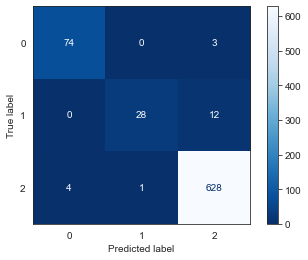

In [282]:
diabetes_rf = data_new
diabetes_rf.head()

# define input and output features to train model
X = diabetes_rf.drop(['CLASS'], axis=1)
y = diabetes_rf.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42, stratify=y)

model_rf = RandomForestClassifier()
model_rf.fit(X_train, y_train)

y_pred = model_rf.predict(X_test)

print(metrics.classification_report(y_test, model_rf.predict(X_test)))
print("Training accuracy {:4f}".format(model_rf.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_rf.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_rf, X_test, y_test, cmap='Blues_r')

print("the f1 score for Random Forest Classifier is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("Random Forest Accuracy is : %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

## 7.4 KNN

              precision    recall  f1-score   support

           0       0.59      0.79      0.68        76
           1       0.57      0.10      0.17        39
           2       0.94      0.95      0.95       635

    accuracy                           0.89       750
   macro avg       0.70      0.62      0.60       750
weighted avg       0.89      0.89      0.88       750

Training accuracy 0.912000
Testing accuracy 0.893333
-------------------------------------------------
the f1 score for Support Vector machine is : 0.6003261990044756
the precision score is : 0.703137737004675
the recall score is : 0.6154561651453487
KNN accuracy is : 0.893
-------------------------------------------------
Number of mislabeled points out of a total 750 points : 80


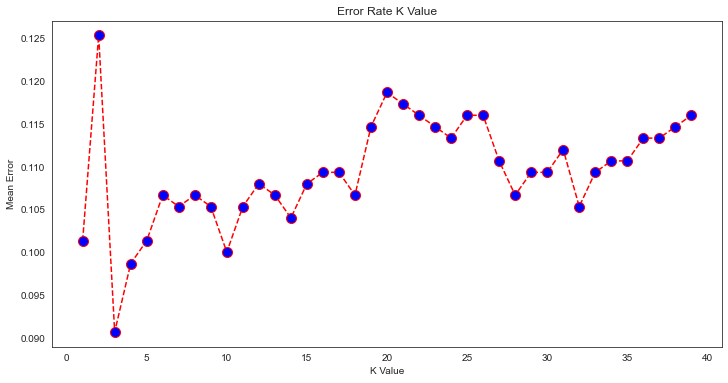

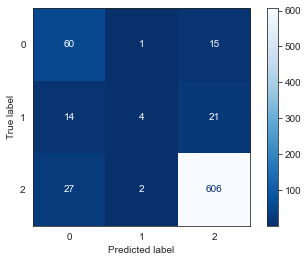

In [283]:
diabetes_knn = data_new
diabetes_knn.head()

# define input and output features to train model
X = diabetes_knn.drop(['CLASS', 'Gender', 'VLDL'], axis=1)
y = diabetes_knn.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75)

scaler = StandardScaler()
scaler.fit(X_train)

X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

model_knn = KNeighborsClassifier(n_neighbors=8)
model_knn.fit(X_train, y_train)

y_pred = model_knn.predict(X_test)

error = []

# Calculating error for K values between 1 and 40
for i in range(1, 40):
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(X_train, y_train)
    pred_i = knn.predict(X_test)
    error.append(np.mean(pred_i != y_test))

plt.figure(figsize=(12, 6))
plt.plot(range(1, 40), error, color='red', linestyle='dashed', marker='o',
         markerfacecolor='blue', markersize=10)
plt.title('Error Rate K Value')
plt.xlabel('K Value')
plt.ylabel('Mean Error')

print(metrics.classification_report(y_test, model_knn.predict(X_test)))
print("Training accuracy {:4f}".format(model_knn.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_knn.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_knn, X_test, y_test, cmap='Blues_r')

print("the f1 score for Support Vector machine is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("KNN accuracy is : %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

## 7.5 Support Vector Machine

c:\languages\python\python390\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\languages\python\python390\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\languages\python\python390\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\languages\python\python390\lib\site-p

              precision    recall  f1-score   support

           0       0.20      0.10      0.13        91
           1       0.00      0.00      0.00        49
           2       0.85      0.96      0.90       760

    accuracy                           0.82       900
   macro avg       0.35      0.35      0.34       900
weighted avg       0.74      0.82      0.77       900

Training accuracy 0.890000
Testing accuracy 0.816667
-------------------------------------------------
the f1 score for Support Vector machine is : 0.3436717047006576
the precision score is : 0.3485897566439263
the recall score is : 0.35138808559861195
Support Vector machine accuracy is : 0.817
-------------------------------------------------
Number of mislabeled points out of a total 900 points : 165


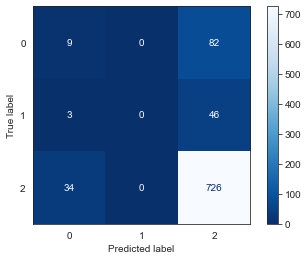

In [284]:
diabetes_svm = data_new
diabetes_svm.head()

# define input and output features to train model
X = diabetes_svm.drop(['CLASS', 'Gender', 'VLDL'], axis=1)
y = diabetes_svm.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.90, random_state=42)

model_SVM = SVC(random_state=0, probability=True, C=80.0, gamma=0.00002, kernel='rbf')
model_SVM.fit(X_train, y_train)

y_pred = model_SVM.predict(X_test)

print(metrics.classification_report(y_test, model_SVM.predict(X_test)))
print("Training accuracy {:4f}".format(model_SVM.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_SVM.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_SVM, X_test, y_test, cmap='Blues_r')

print("the f1 score for Support Vector machine is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("Support Vector machine accuracy is : %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

## 7.6 Decision tree

              precision    recall  f1-score   support

           0       0.92      1.00      0.96        22
           1       1.00      1.00      1.00        10
           2       1.00      0.99      1.00       218

    accuracy                           0.99       250
   macro avg       0.97      1.00      0.98       250
weighted avg       0.99      0.99      0.99       250

Training accuracy 1.000000
Testing accuracy 0.992000
-------------------------------------------------
the f1 score for Decision tress is : 0.9839711480665198
the precision score is : 0.9722222222222222
the recall score is : 0.9969418960244649
Support Decision Tree accuracy is : 0.992
-------------------------------------------------
Number of mislabeled points out of a total 250 points : 2


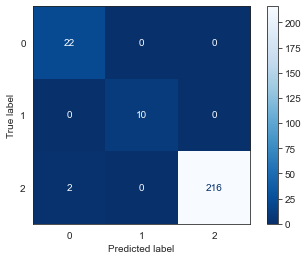

In [285]:
diabetes_dt = data_new
diabetes_dt.head()

# define input and output features to train model
X = diabetes_dt.drop('CLASS', axis=1)
y = diabetes_dt.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)

model_dt = DecisionTreeClassifier(random_state=42)
model_dt.fit(X_train, y_train)

#path = model_dt.cost_complexity_pruning_path(X_train, y_train)

y_pred = model_dt.predict(X_test)

#ccp_alphas, impurities = path.ccp_alphas, path.impurities

'''fig, ax = plt.subplots()
ax.plot(ccp_alphas[:-1], impurities[:-1], marker="o", drawstyle="steps-post")
ax.set_xlabel("effective alpha")
ax.set_ylabel("total impurity of leaves")
ax.set_title("Total Impurity vs effective alpha for training set")'''

print(metrics.classification_report(y_test, model_dt.predict(X_test)))
print("Training accuracy {:4f}".format(model_dt.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_dt.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_dt, X_test, y_test, cmap='Blues_r')

print("the f1 score for Decision tress is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("Support Decision Tree accuracy is : %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

## 7.7 Naive Bayes

              precision    recall  f1-score   support

           0       0.61      0.81      0.70        78
           1       0.78      0.64      0.71        45
           2       0.97      0.94      0.96       627

    accuracy                           0.91       750
   macro avg       0.79      0.80      0.79       750
weighted avg       0.92      0.91      0.91       750

Training accuracy 0.952000
Testing accuracy 0.910667
-------------------------------------------------
the f1 score for Naive Bayes is : 0.7863290869338838
the precision score is : 0.7880955760790235
the recall score is : 0.7982401613980562
Support Naive Bayes accuracy is : 0.911
-------------------------------------------------
Number of mislabeled points out of a total 750 points : 67


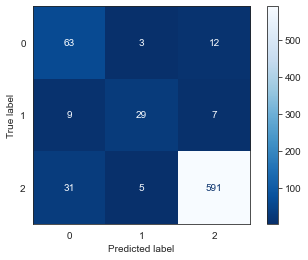

In [286]:
diabetes_nb = data_new
diabetes_nb.head()

# define input and output features to train model
X = diabetes_nb.drop('CLASS', axis=1)
y = diabetes_nb.CLASS

# train and test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42)

model_gnb = GaussianNB()
y_pred = model_gnb.fit(X_train, y_train).predict(X_test)

print(metrics.classification_report(y_test, model_gnb.predict(X_test)))
print("Training accuracy {:4f}".format(model_gnb.score(X_train, y_train)))
print("Testing accuracy {:4f}".format(model_gnb.score(X_test, y_test)))
print("-------------------------------------------------")

metrics.plot_confusion_matrix(model_gnb, X_test, y_test, cmap='Blues_r')

print("the f1 score for Naive Bayes is :", (f1_score(y_test, y_pred, average="macro")))
print("the precision score is :", (precision_score(y_test, y_pred, average="macro")))
print("the recall score is :", (recall_score(y_test, y_pred, average="macro")))
print("Support Naive Bayes accuracy is : %.3f" % metrics.accuracy_score(y_test, y_pred))
print("-------------------------------------------------")
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

# 8. Displaying Best Model

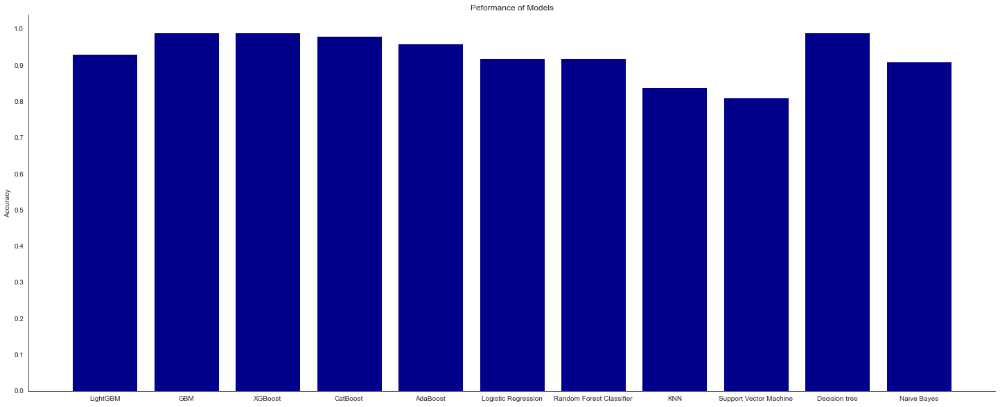

In [288]:
# Plot accuracies of supervised-machine learning models
best_scores = {'LightGBM': .93,
               'GBM': .99,
               'XGBoost': .99,
               'CatBoost': .98,
               'AdaBoost': .96,
               'Logistic Regression': .92,
               'Random Forest Classifier': .92,
               'KNN': .84,
               'Support Vector Machine': .81,
               'Decision tree': .99,
               'Naive Bayes': .91}

sns.set_style('white')
plt.figure(figsize=(25, 10))
plt.bar(best_scores.keys(), best_scores.values(), color='darkblue')
plt.yticks(ticks=np.linspace(0, 1.0, 11))
plt.ylabel('Accuracy')
plt.title('Peformance of Models')
sns.despine()
plt.show();